# MLP Regressor

### Librerías

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score as r2
from sklearn.metrics import mean_squared_error as rmse
from sklearn.metrics import mean_absolute_error as mae
from sklearn import preprocessing

### Funciones

In [2]:
# Formatea las variables de tal forma que las pueda admitir la ANN
def fix_parameters(X, m, delta):
    left_stop = (m + delta)
    tam = X.size - left_stop
    i = X.size - 1
    X_fixed = []
    y_fixed = []
    while i >= left_stop:
        X_fixed = np.append(X_fixed, X[(i + 1 - left_stop):(i + 1) - delta])
        y_fixed = np.append(y_fixed, X[i])
        i = i - 1
    X_fixed = np.reshape(X_fixed, (tam, m))
  
    return X_fixed, y_fixed

In [3]:
# Mostramos la tabla comparativa entre los valores originales y los predichos
def print_comparative_plot(m, delta, y, pred):
    plt.figure(num= str(m) +", "+ str(delta), figsize=(40, 10))
    plt.suptitle("M: " + str(m) +", Delta: "+ str(delta))
    plt.plot(range(y.size), np.flip(y), c="b")
    plt.plot(range(pred.size), np.flip(pred), c="r")            
    plt.show()

In [4]:
# Mostrar la gráfica con la evolución de los errores
def print_error_plot(m, delta, y, pred):
    plt.figure(num= "Error: " + str(m) +", "+ str(delta), figsize=(40, 10))
    plt.suptitle("Error para M: " + str(m) +", Delta: "+ str(delta))
    plt.plot(range(y.size), np.flip(np.abs(np.subtract(y, pred))), c="g")
    plt.show()

### Preprocesamos los datos 

In [6]:
# Extraemos los datos del .csv
col_list = ["Wind Speed (m/s)", "LV ActivePower (kW)", "Wind Direction (°)"] # "Wind Speed (m/s)", "LV ActivePower (kW)", "Wind Direction (°)"
# Tan solo escogemos los datos medidos cada 20 minutos
data = pd.read_csv('dataset.csv', usecols=col_list, encoding='utf-8', skiprows=lambda x: (x != 0) and not x % 2)

data

,LV ActivePower (kW),Wind Speed (m/s),Wind Direction (°)
0,380.047791,5.311336,259.994904
1,306.376587,5.216037,272.564789
2,380.650696,5.577941,265.674286
3,447.605713,5.793008,266.163605
4,463.651215,5.584629,253.480698
...,...,...,...
25260,2771.110107,10.154550,82.335197
25261,3455.282959,12.195660,82.210617
25262,3514.269043,12.559170,80.495262
25263,1684.353027,7.332648,84.062599


### Establecemos los parámetros 

In [6]:
# Definimos el porcentaje de division d los datasets de train y test
test_size = 0.4
# Definimos los parametros de tiempo 
m_values = np.array([72, 216, 504]) # 1, 3 días y 1 semana
delta_values = np.array([3, 18, 36, 72]) # 1 hora, 12 horas y 1 día
#Definimos los parametros del algoritmo
max_iter_value = 500
shuffle_value = False
hidden_layer_sizes_value = (100, 50, 25)
random_state_value = 7
early_stopping_value = True
# solver = 'adam'

In [7]:
# Configuramos el tamaño de las gráficas
plt.rcParams["figure.figsize"] = (90, 10)

### Ejecutamos el código para cada columna del dataset

LV ActivePower (kW)
M:  72 , Delta:  3
RMSE:  529.3002864591923 , MAE:  371.60423652458263 , R2:  0.8370745607876355


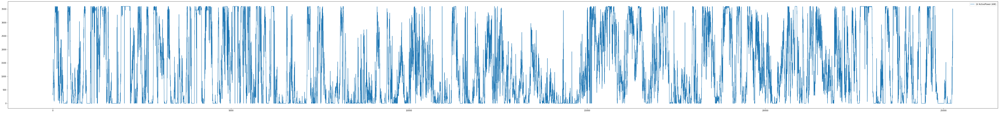

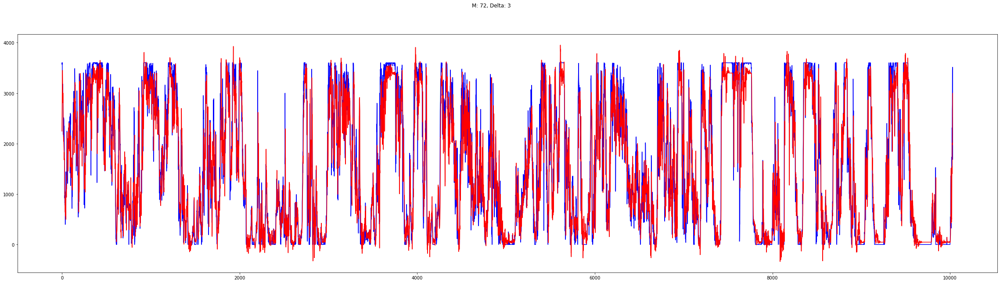

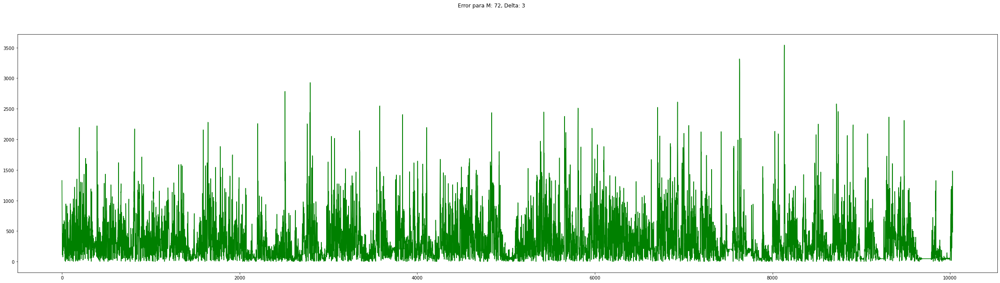

M:  72 , Delta:  18
RMSE:  1100.4885802774347 , MAE:  810.3197878593239 , R2:  0.29525856942510476


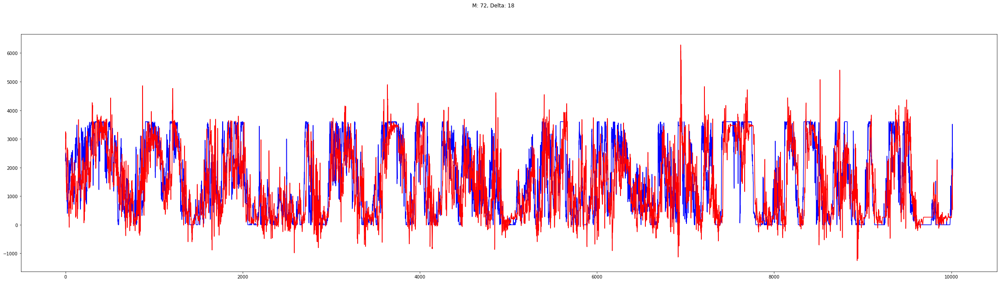

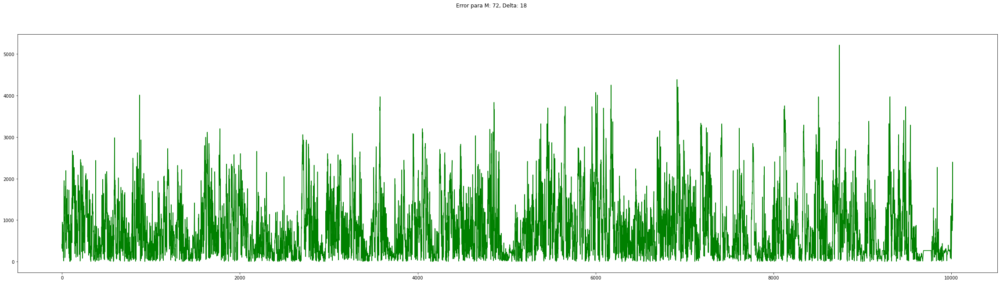

M:  72 , Delta:  36
RMSE:  1291.1960558939504 , MAE:  999.7627211748445 , R2:  0.031048037229644665


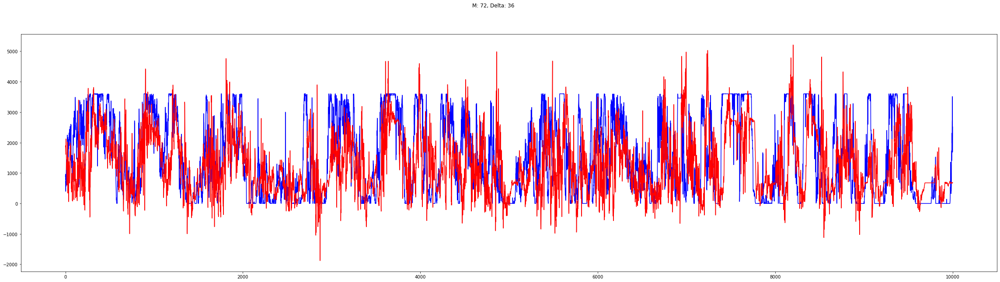

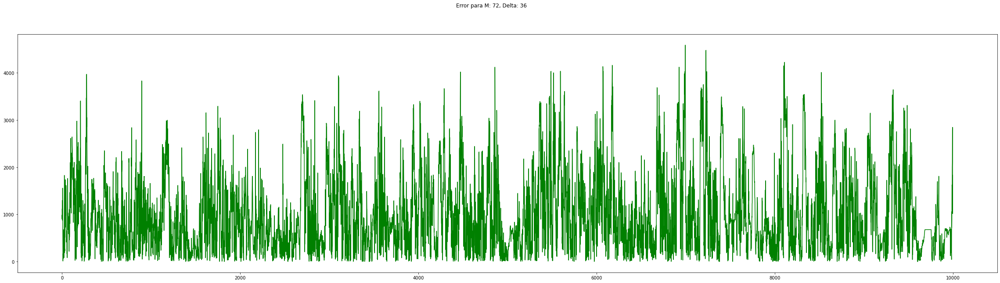

M:  72 , Delta:  72
RMSE:  1433.9408587080463 , MAE:  1132.0012772981788 , R2:  -0.19143096330418619


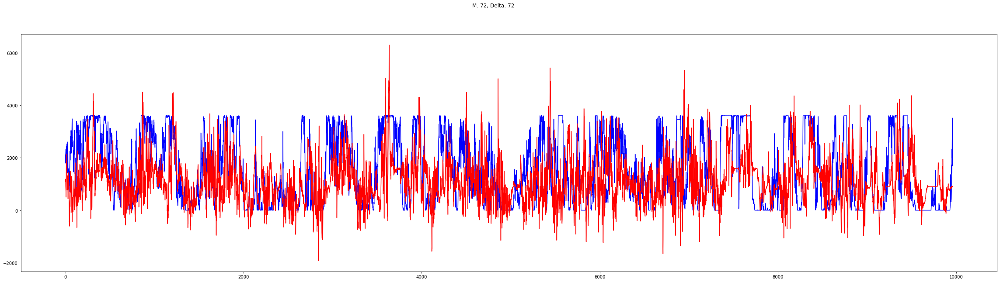

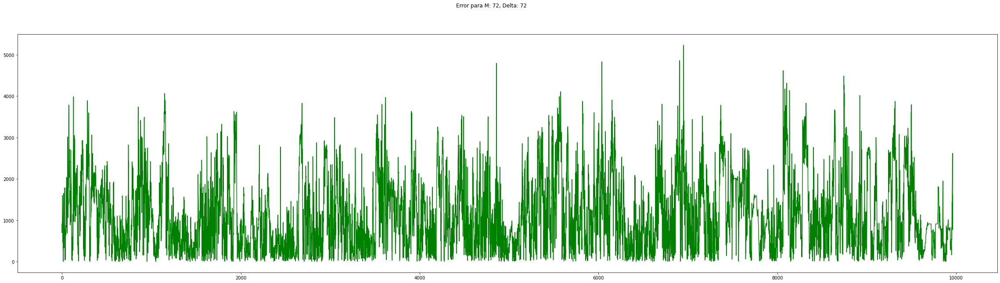

M:  216 , Delta:  3
RMSE:  679.0903102466635 , MAE:  500.84080859672207 , R2:  0.734133178325754


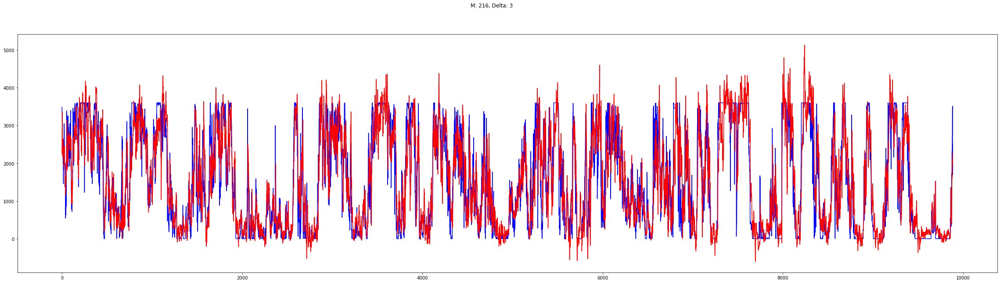

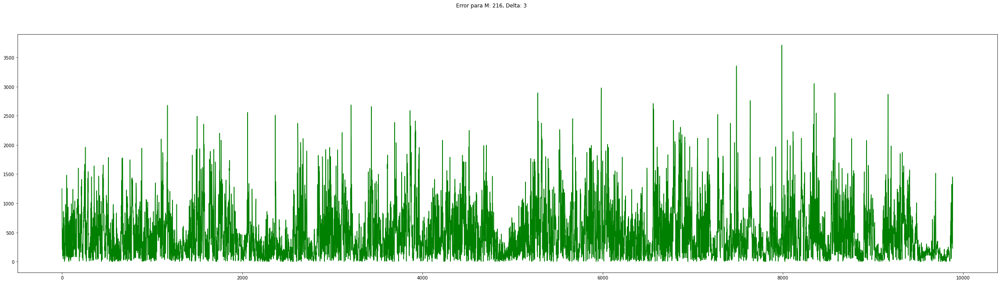

M:  216 , Delta:  18
RMSE:  1204.5123118743813 , MAE:  921.8071967096758 , R2:  0.1637274539261715


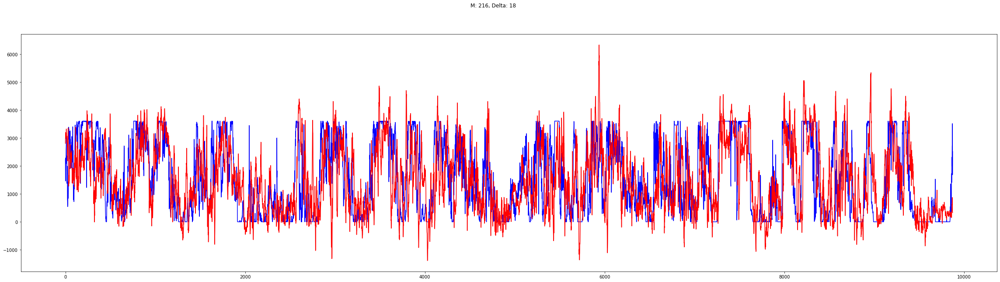

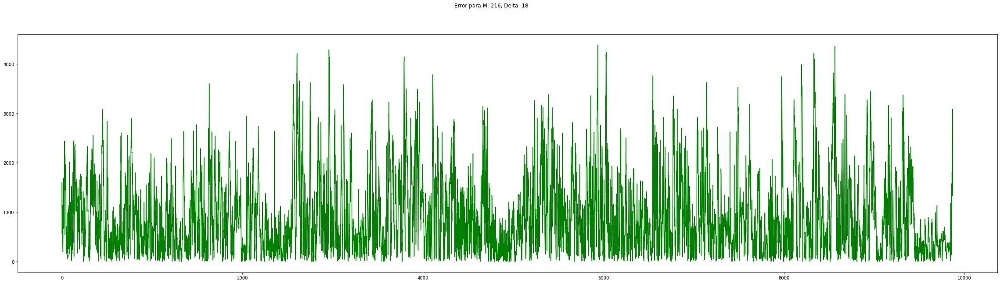

M:  216 , Delta:  36
RMSE:  1459.4461022088155 , MAE:  1137.2659560038169 , R2:  -0.22630014468572512


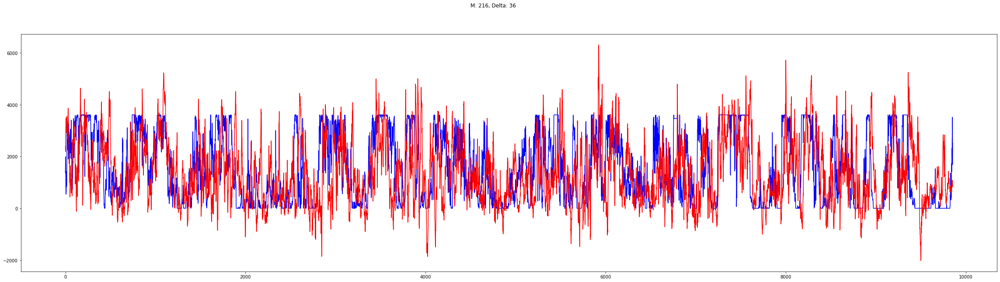

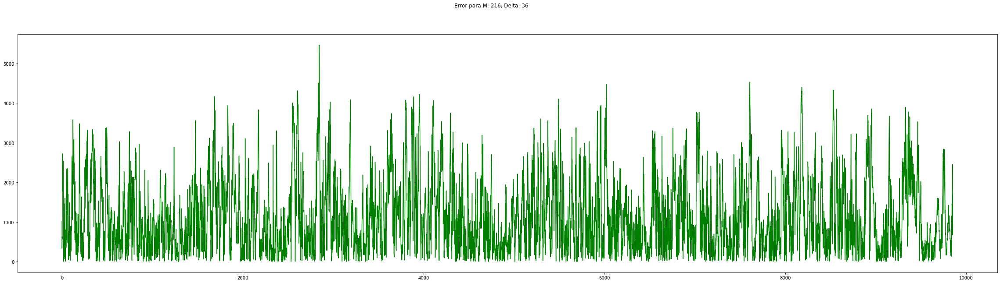

M:  216 , Delta:  72
RMSE:  1610.8144341860686 , MAE:  1289.745953047194 , R2:  -0.49243178116611985


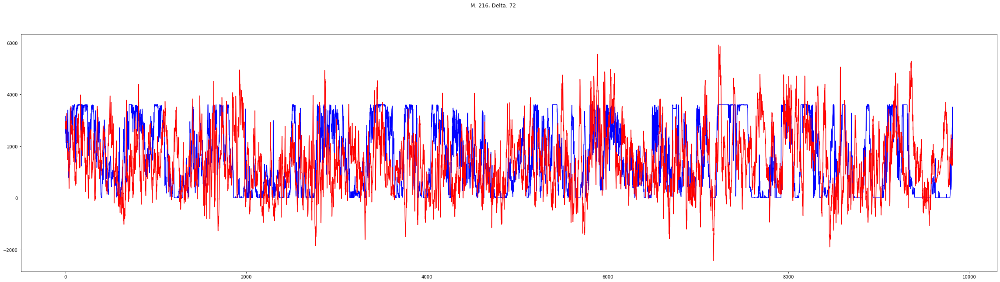

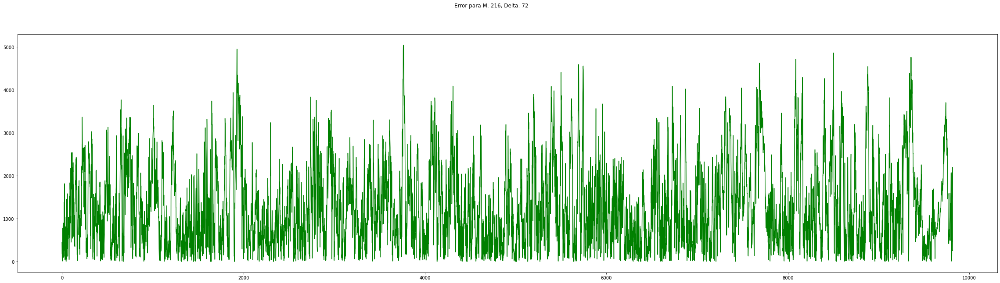

M:  504 , Delta:  3
RMSE:  785.357426540564 , MAE:  606.8550672959072 , R2:  0.6400174023646682


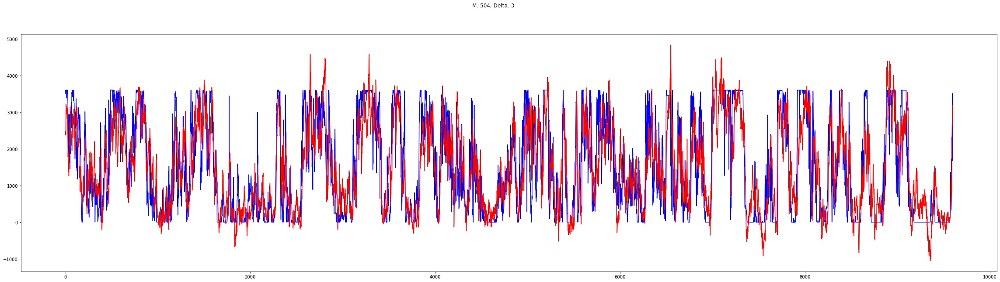

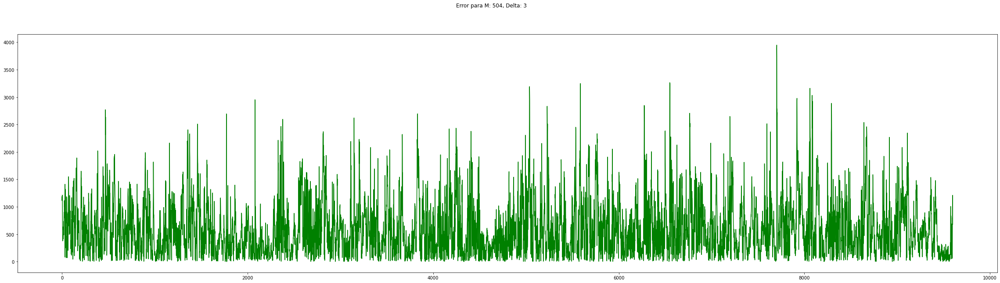

M:  504 , Delta:  18
RMSE:  1246.8679430093198 , MAE:  974.3695491365639 , R2:  0.09050746633254692


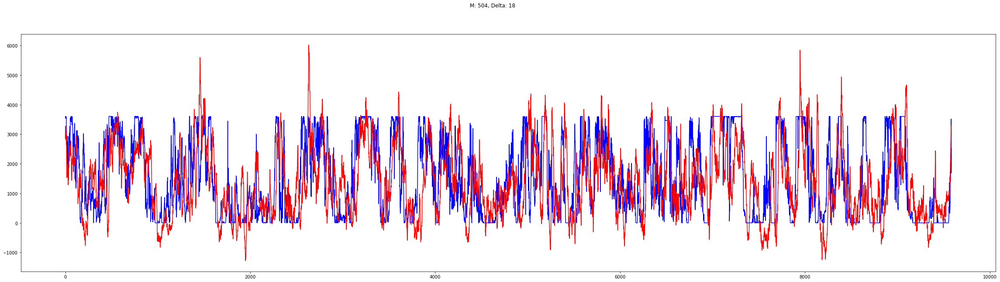

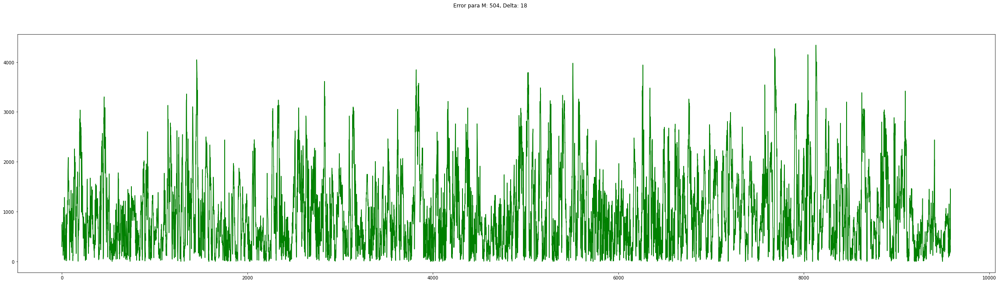

M:  504 , Delta:  36
RMSE:  1525.1969640138313 , MAE:  1210.4130991311213 , R2:  -0.3631321699034604


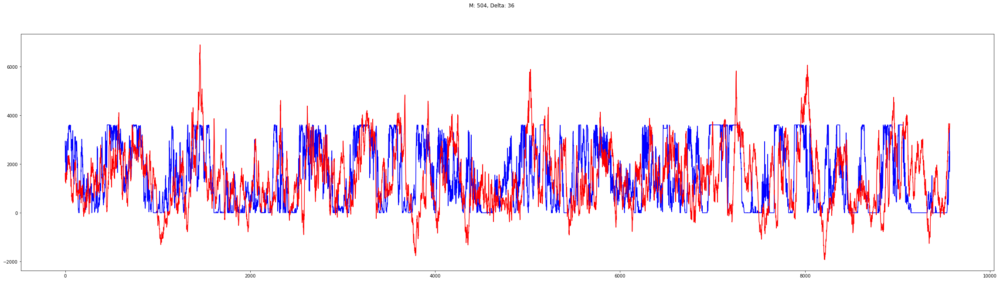

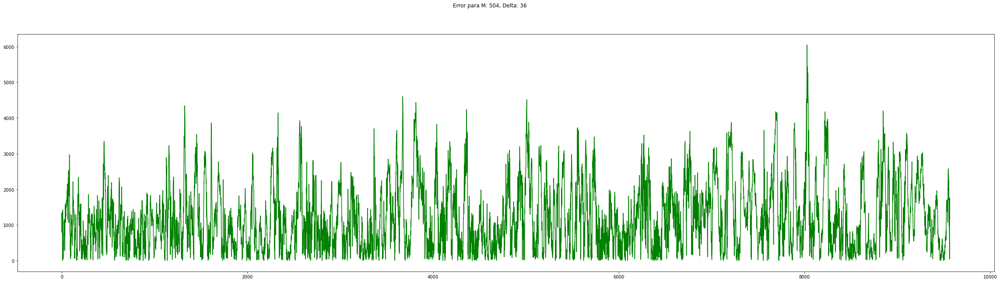

M:  504 , Delta:  72
RMSE:  1653.500015474171 , MAE:  1333.280295401943 , R2:  -0.6000405265970528


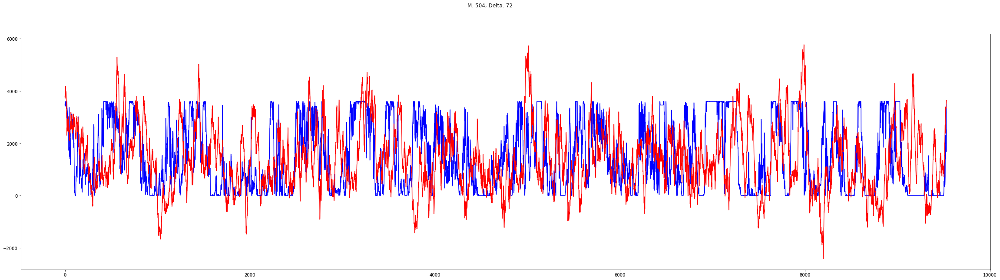

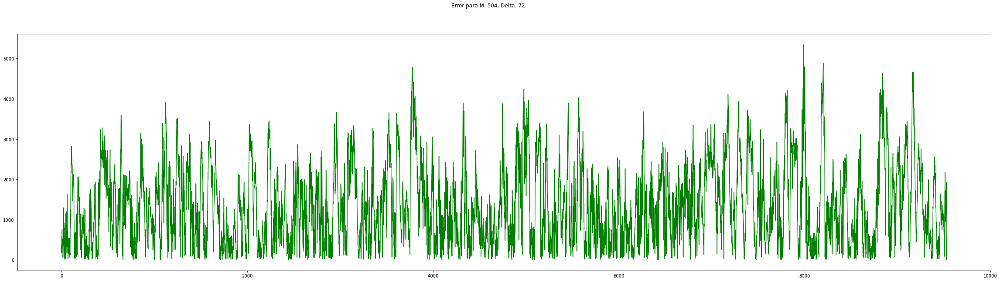

Wind Speed (m/s)
M:  72 , Delta:  3
RMSE:  1.624212431204975 , MAE:  1.2280376365954655 , R2:  0.8281012058044614


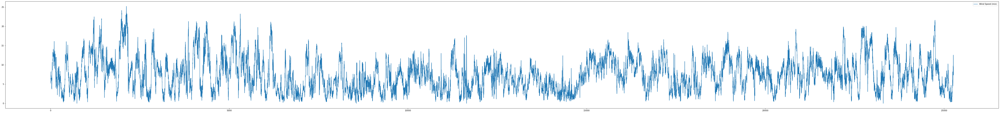

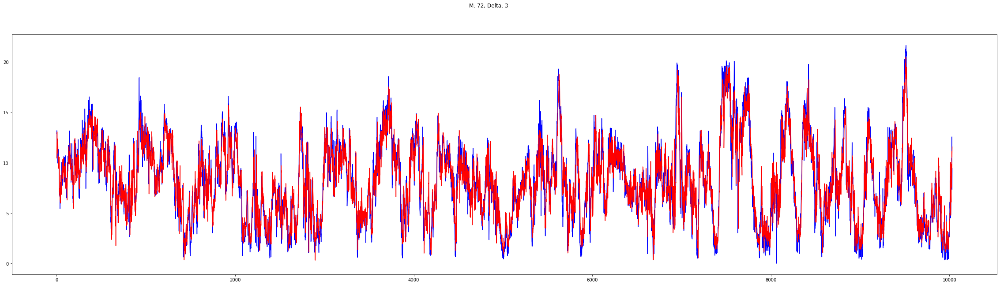

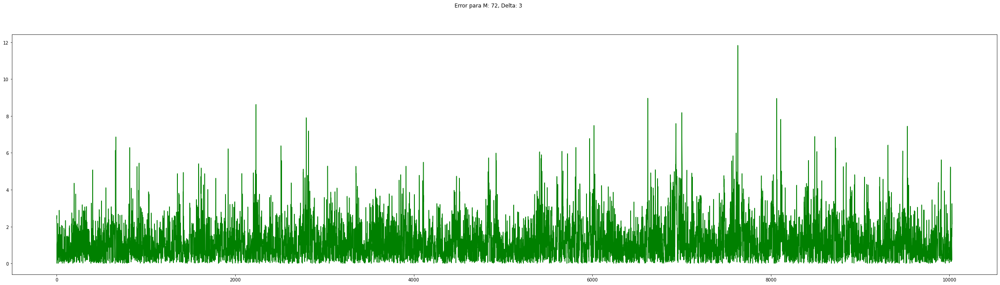

M:  72 , Delta:  18
RMSE:  3.72651501742146 , MAE:  2.8653559740508157 , R2:  0.09526255497784197


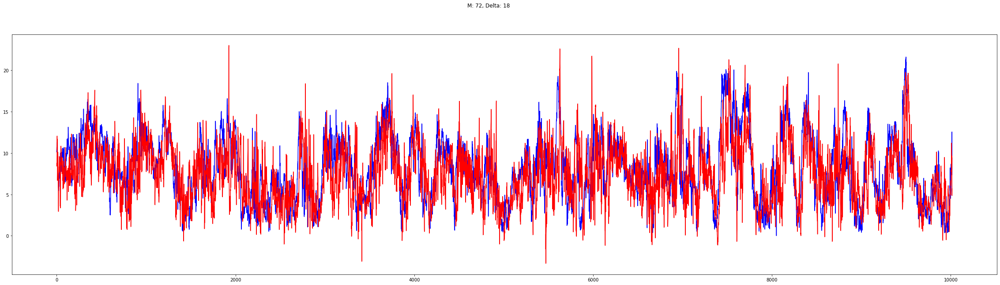

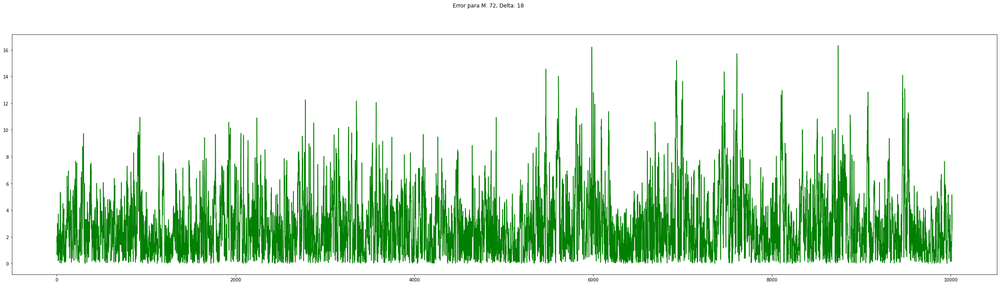

M:  72 , Delta:  36
RMSE:  4.26026203846737 , MAE:  3.3328407152421087 , R2:  -0.18086449477946198


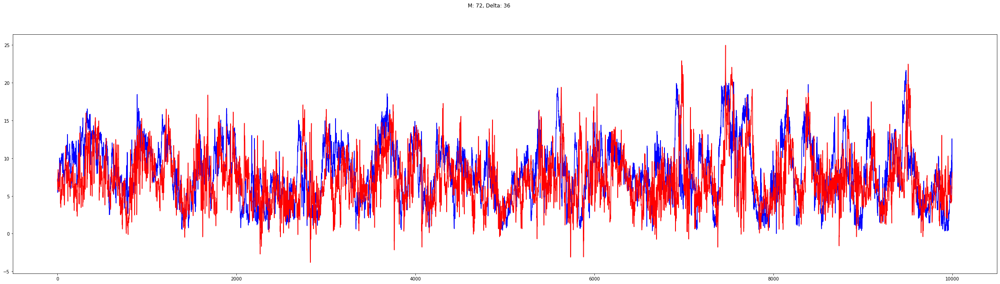

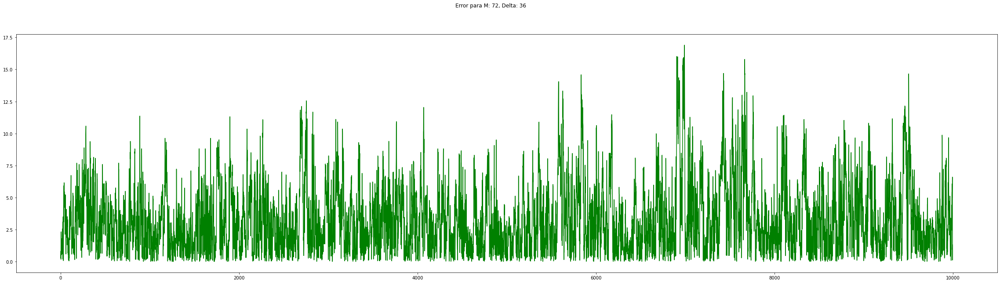

M:  72 , Delta:  72
RMSE:  4.743844650505237 , MAE:  3.698530991737531 , R2:  -0.4593329594286115


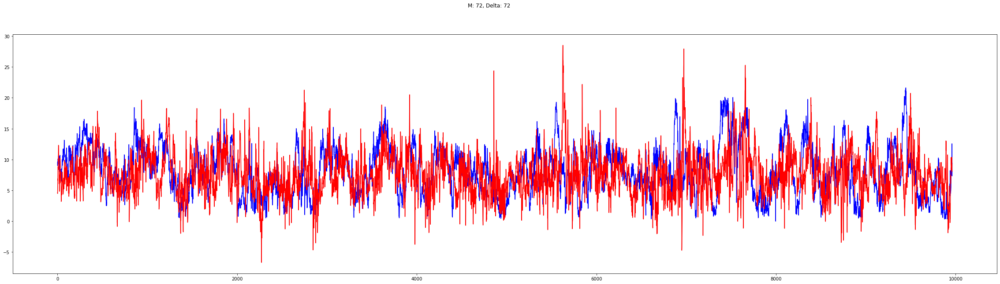

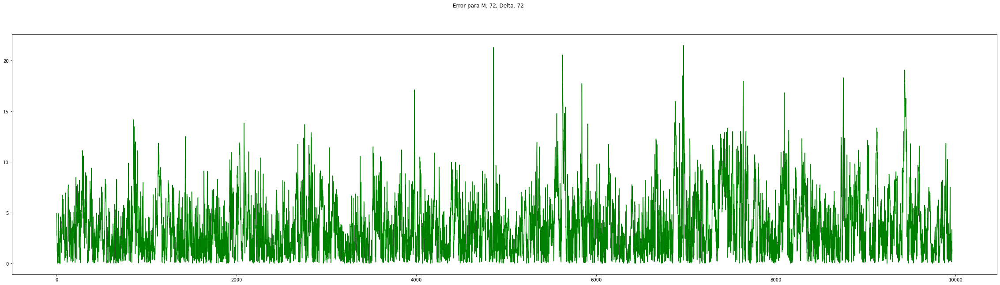

M:  216 , Delta:  3
RMSE:  1.9643446355997396 , MAE:  1.5124901910344088 , R2:  0.7512725495157979


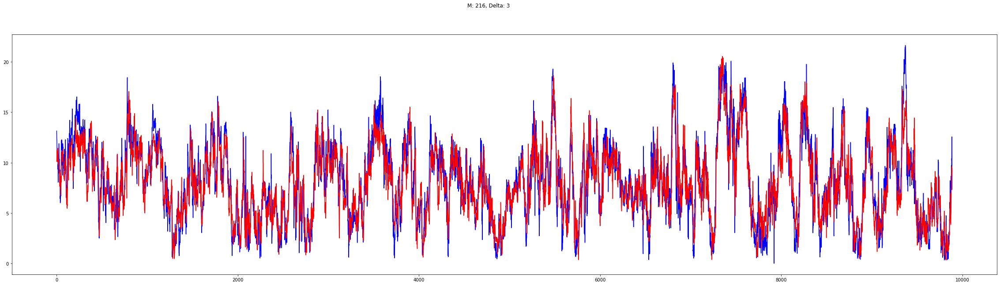

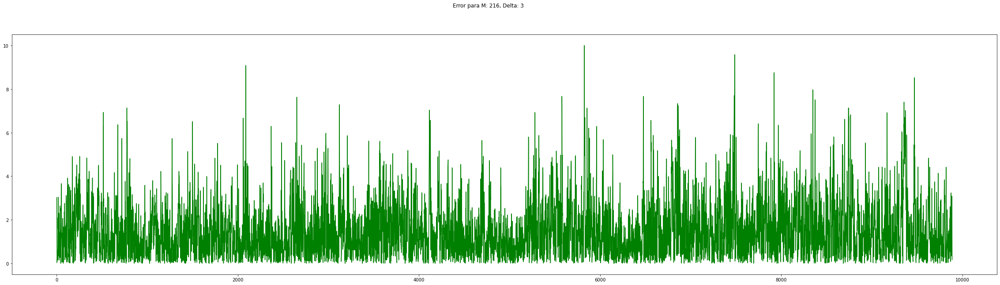

M:  216 , Delta:  18
RMSE:  3.757837385595513 , MAE:  2.903186381005599 , R2:  0.09030631070832118


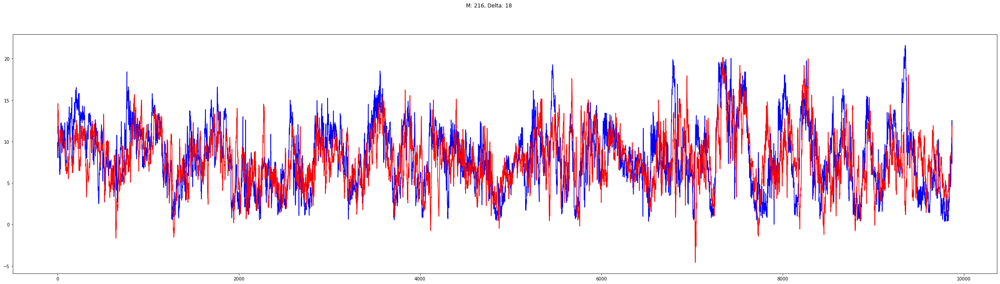

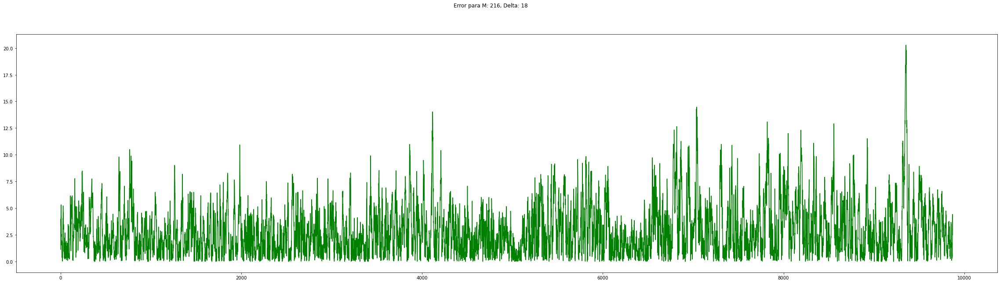

M:  216 , Delta:  36
RMSE:  4.63876663686706 , MAE:  3.6110252954314666 , R2:  -0.3843145785001467


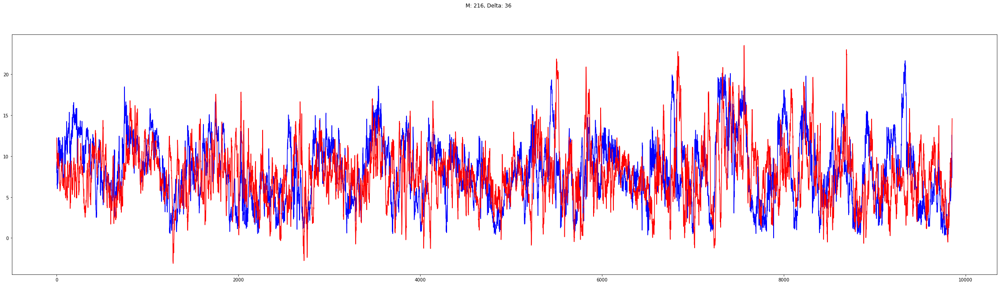

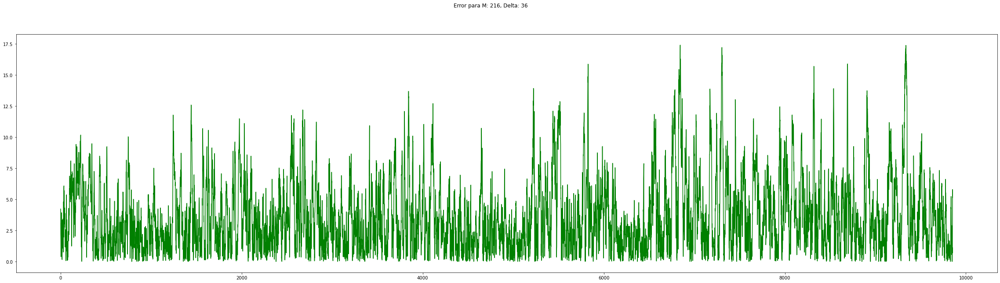

M:  216 , Delta:  72
RMSE:  5.068480821953693 , MAE:  4.0344366095761846 , R2:  -0.6490611270210249


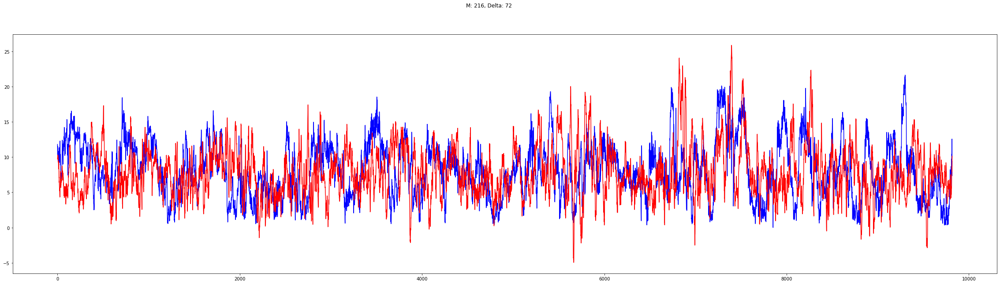

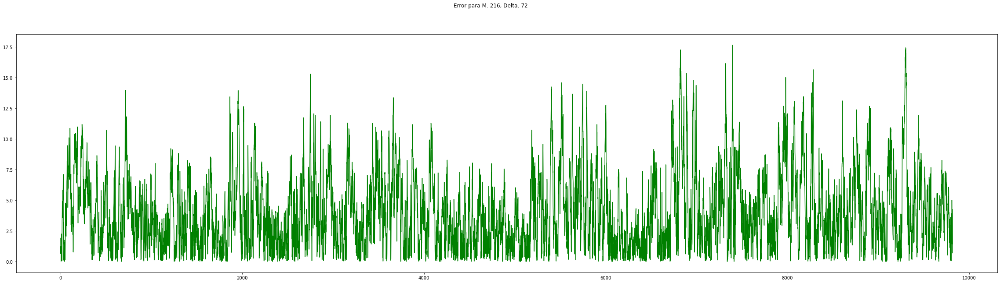

M:  504 , Delta:  3
RMSE:  2.3931134529208284 , MAE:  1.8841409868296042 , R2:  0.6295955474720405


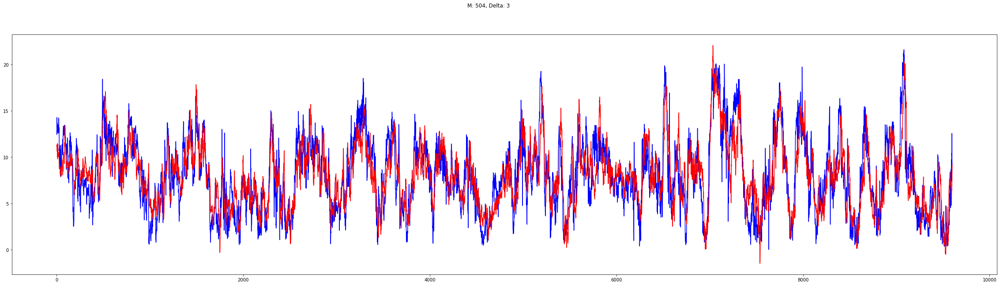

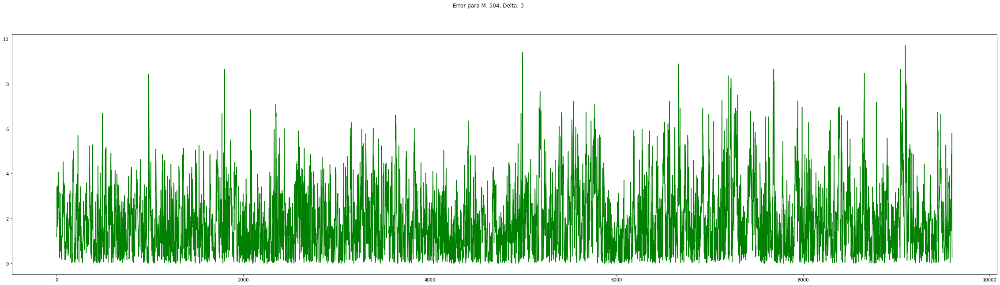

M:  504 , Delta:  18
RMSE:  4.083837436787524 , MAE:  3.2385886005708797 , R2:  -0.07990007296968704


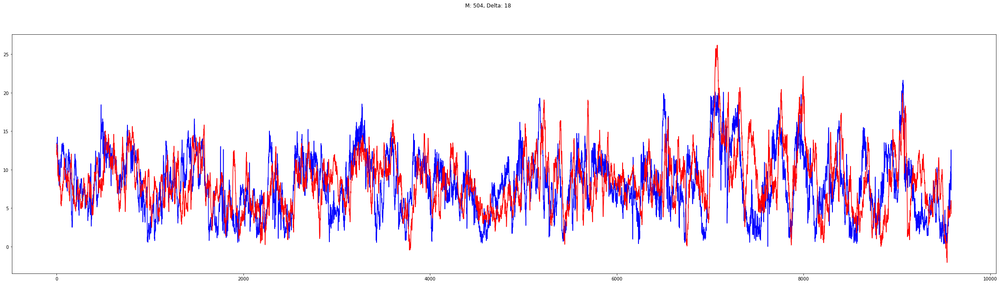

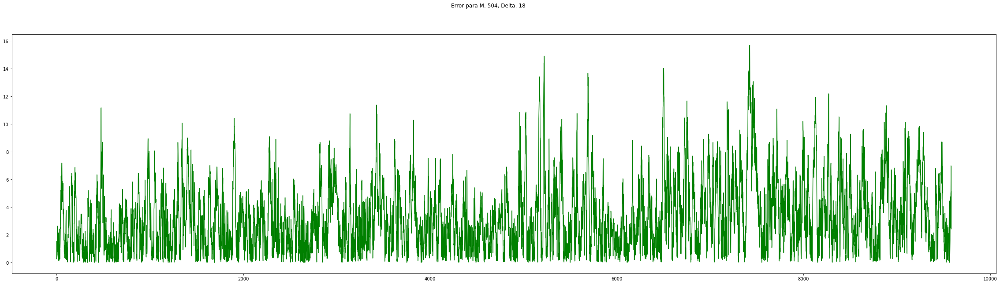

M:  504 , Delta:  36
RMSE:  4.531073880934556 , MAE:  3.553643991310184 , R2:  -0.3301401495318801


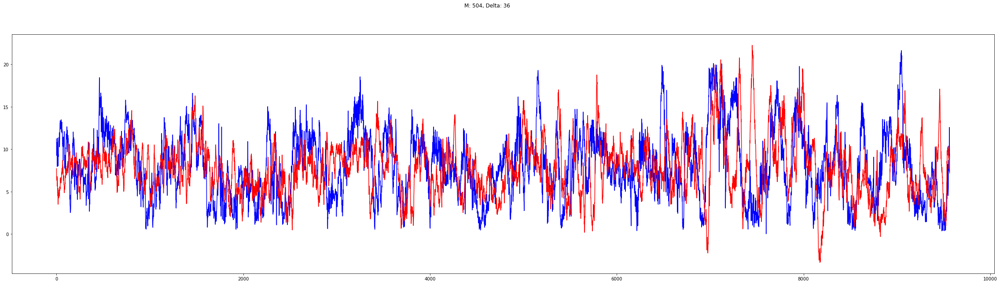

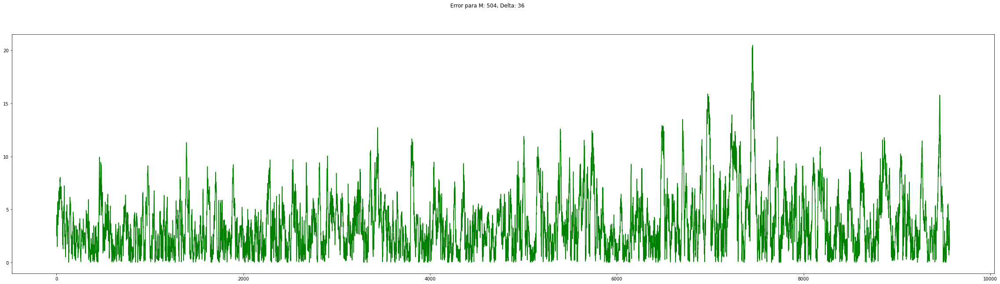

M:  504 , Delta:  72
RMSE:  5.188148371145069 , MAE:  4.119536461469893 , R2:  -0.7395488917187849


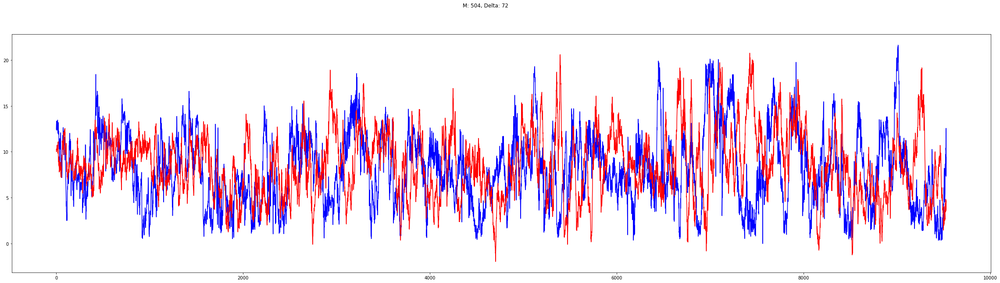

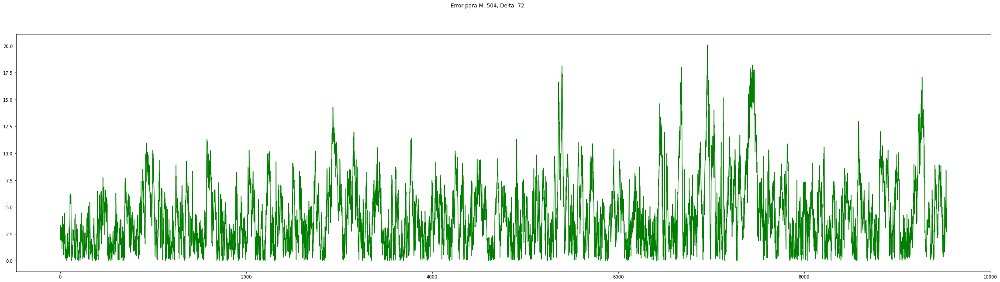

Wind Direction (°)
M:  72 , Delta:  3
RMSE:  46.952151195166365 , MAE:  22.119592420153495 , R2:  0.6939870460847226


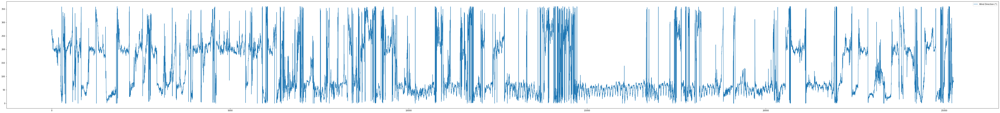

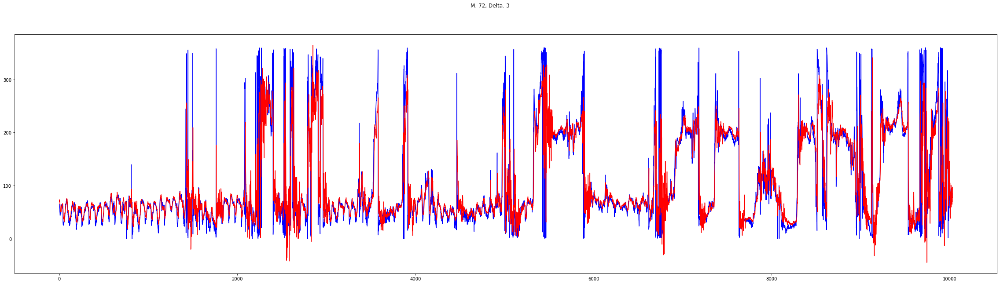

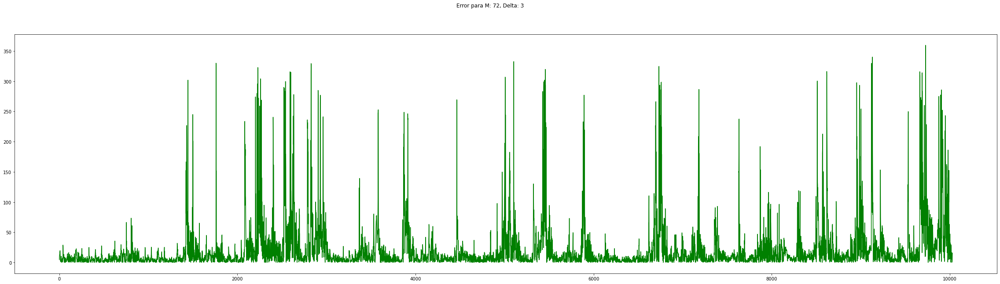

M:  72 , Delta:  18
RMSE:  65.3142744148693 , MAE:  40.024421509662254 , R2:  0.4084121560960421


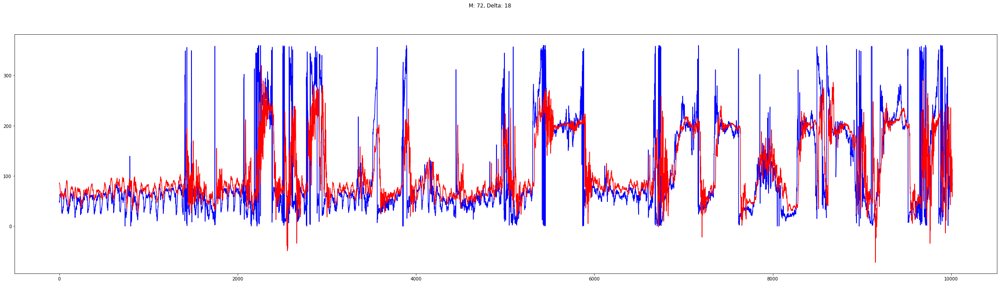

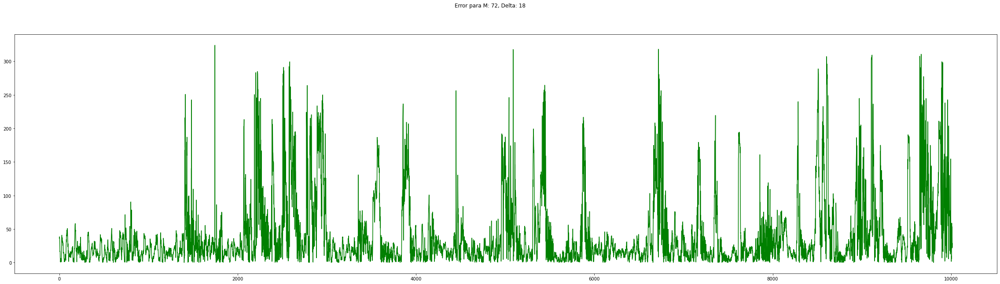

M:  72 , Delta:  36
RMSE:  72.29298421477229 , MAE:  51.585236511748526 , R2:  0.2761889984397363


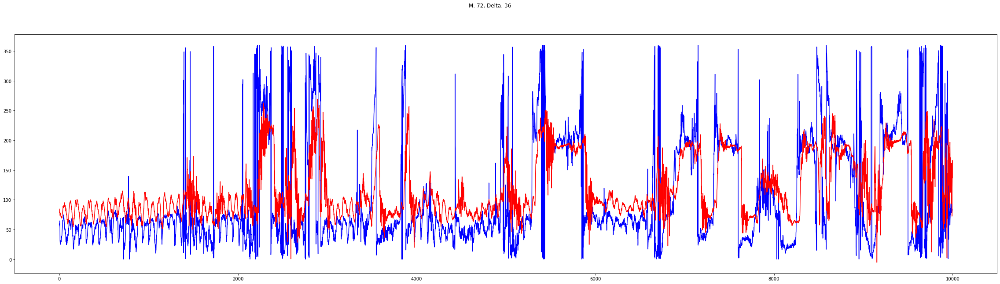

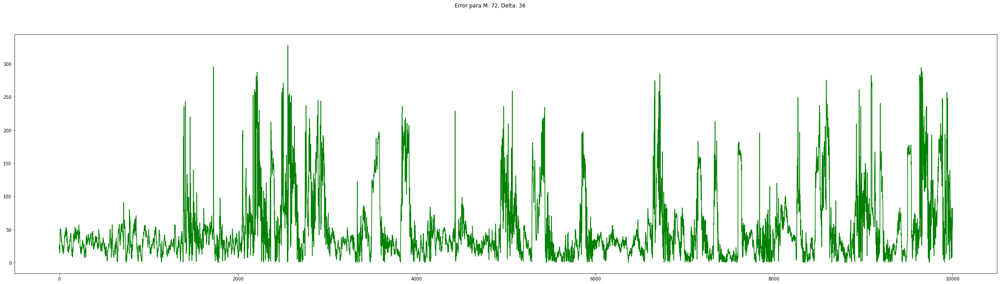

M:  72 , Delta:  72
RMSE:  79.86683734193278 , MAE:  61.96702104850811 , R2:  0.11804920282147113


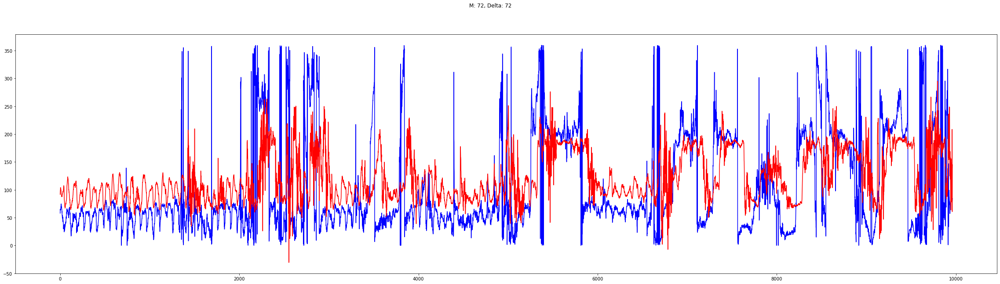

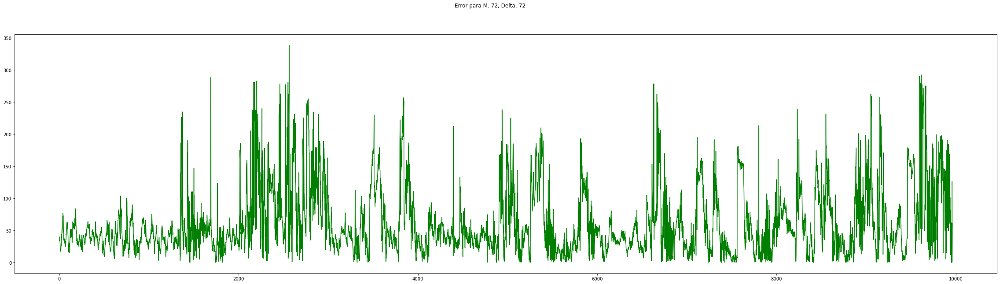

M:  216 , Delta:  3
RMSE:  50.40911171104373 , MAE:  27.261741921914474 , R2:  0.6501804994653404


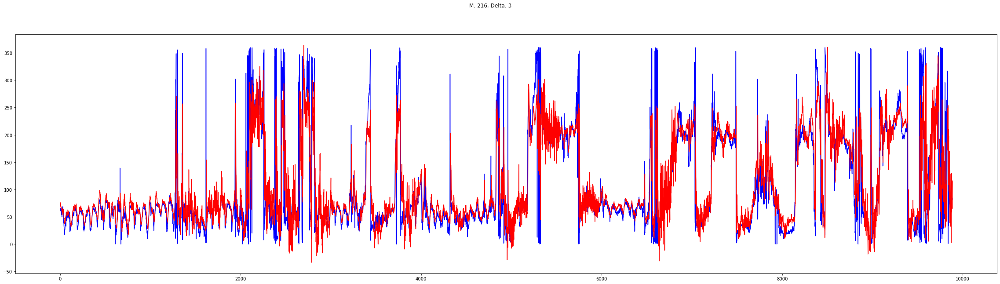

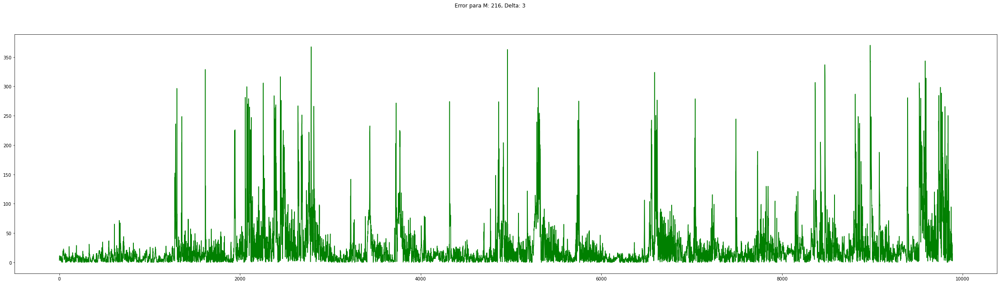

M:  216 , Delta:  18
RMSE:  76.53264657967333 , MAE:  49.47674254130789 , R2:  0.1946017871501149


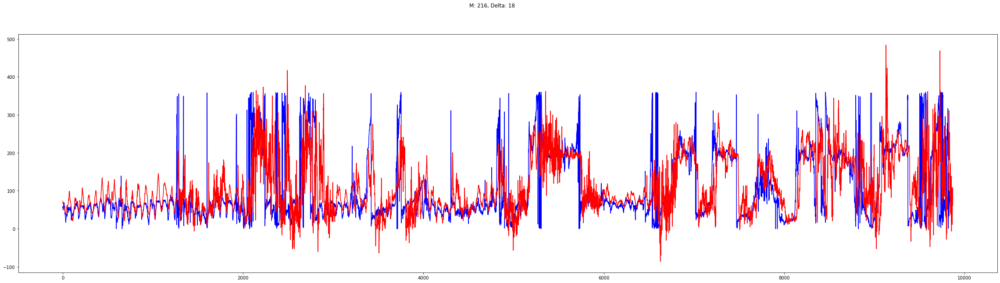

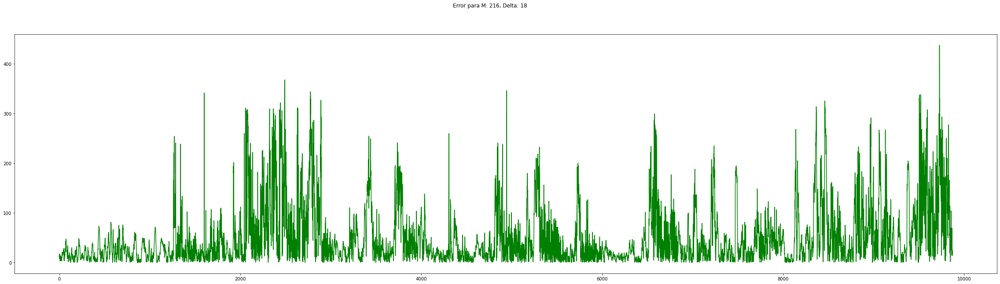

M:  216 , Delta:  36
RMSE:  86.75156595848938 , MAE:  63.03500471758862 , R2:  -0.03341450227456999


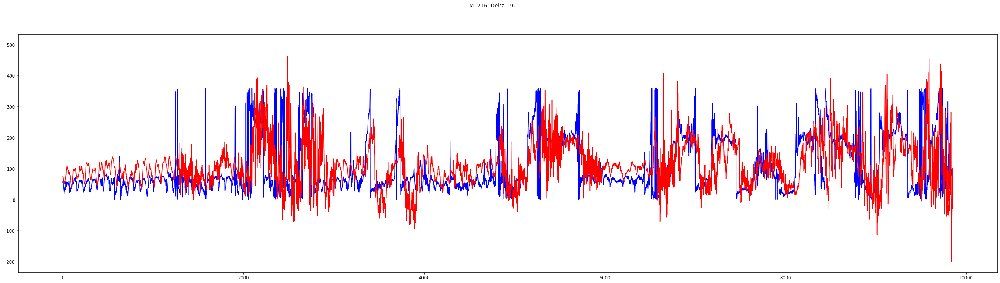

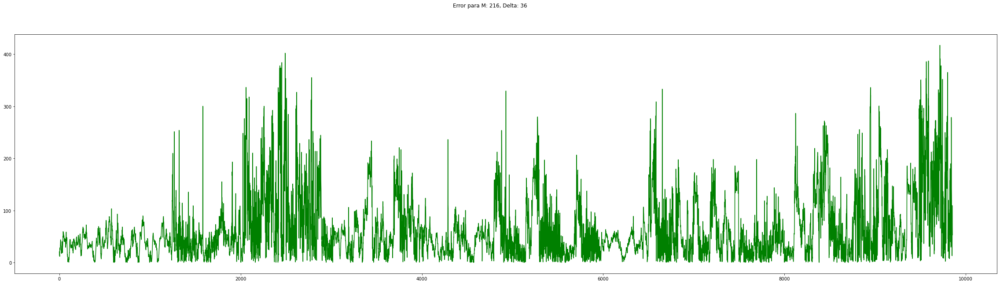

M:  216 , Delta:  72
RMSE:  95.2569972879761 , MAE:  76.5068870680343 , R2:  -0.24425821912255885


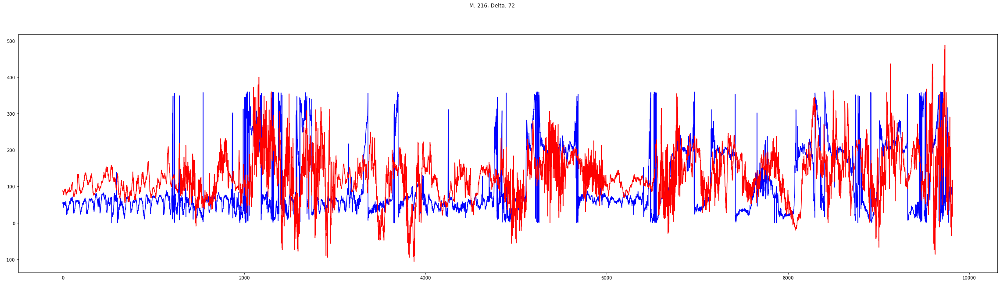

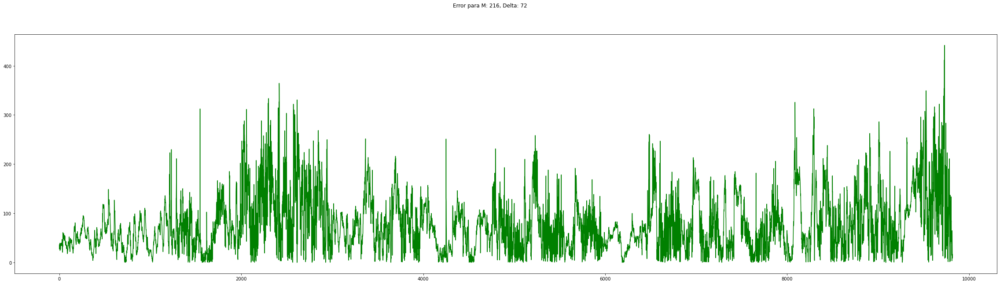

M:  504 , Delta:  3
RMSE:  55.58244688162158 , MAE:  32.99422637985157 , R2:  0.5818633661458408


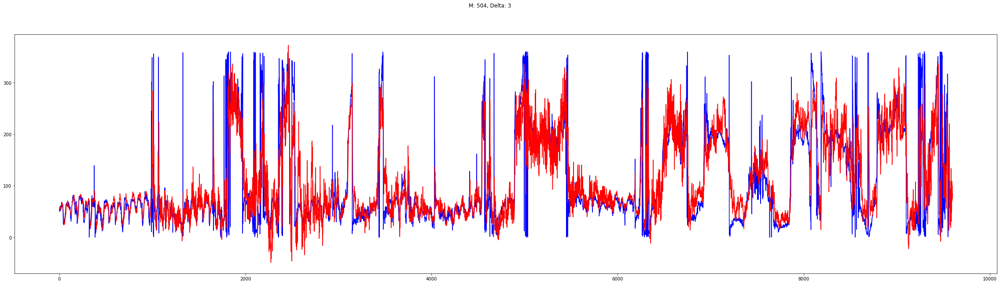

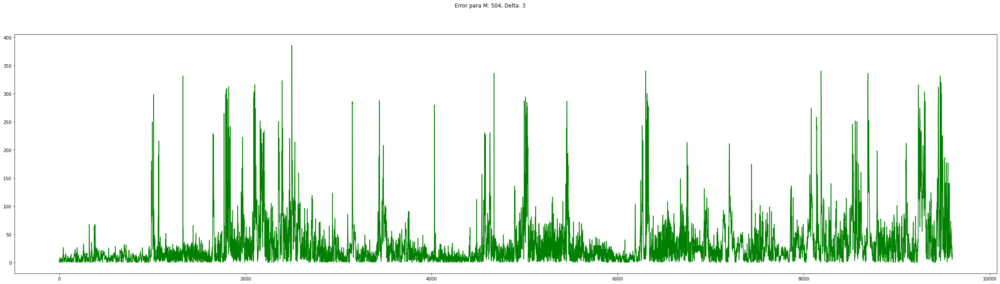

M:  504 , Delta:  18
RMSE:  82.33434905083547 , MAE:  56.077513867759365 , R2:  0.08344179292585541


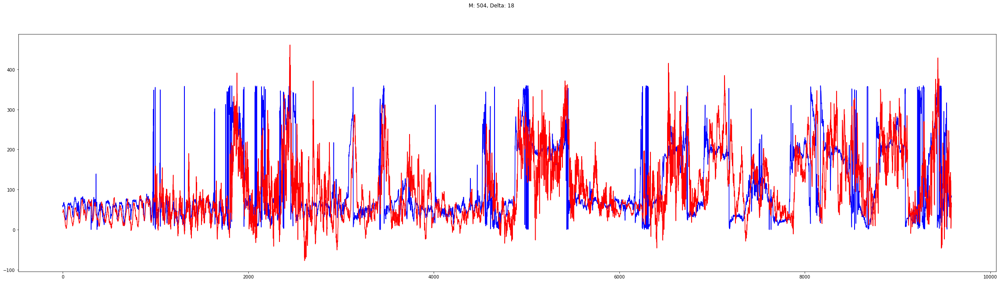

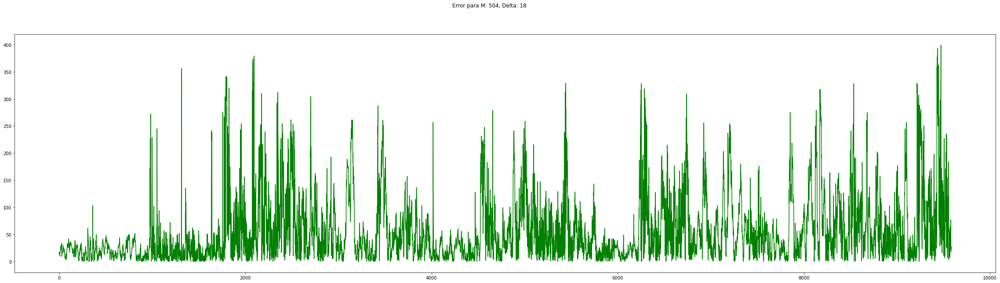

M:  504 , Delta:  36
RMSE:  94.58804853563527 , MAE:  67.72440724832806 , R2:  -0.20795799277942106


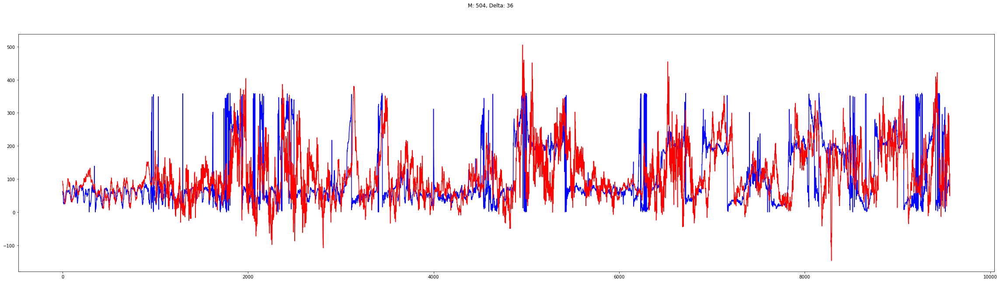

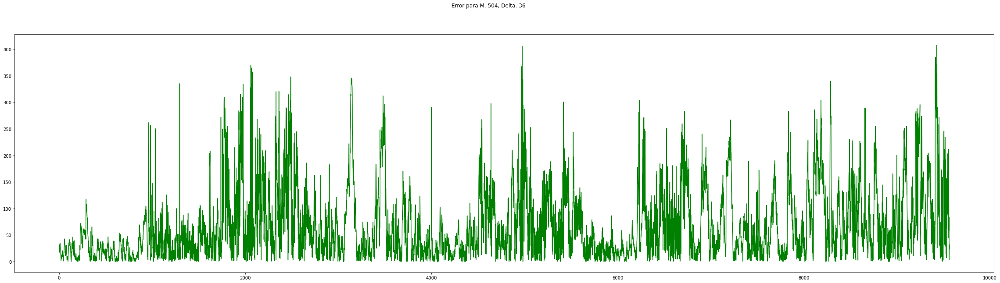

M:  504 , Delta:  72
RMSE:  100.68347443102991 , MAE:  76.26125895925372 , R2:  -0.3665810331470998


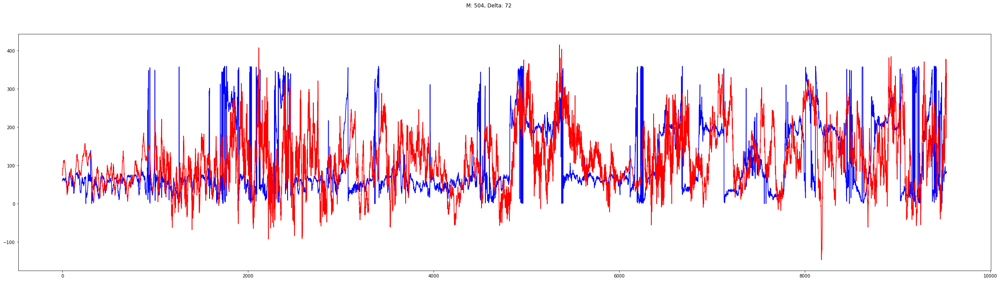

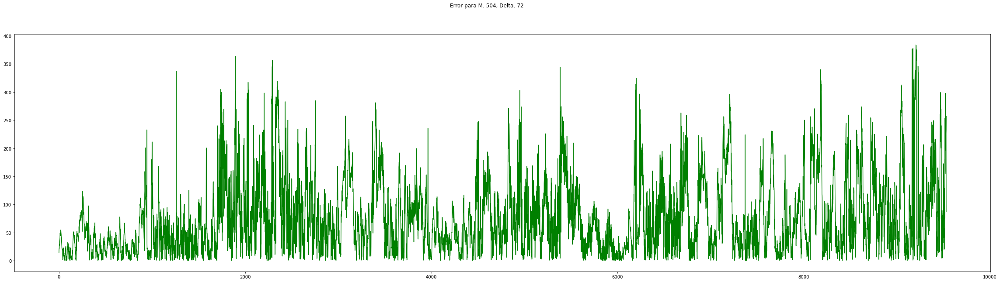

In [8]:
# Para cada parámetro, ejecutamos el código
for column in data:
    # Mostramos la gráfica con la tendencia anual de la velocidad del viento
    data.plot(y = column, kind = 'line')
    # Transformamos la columna a un array para poder tratarlo mejor
    X = data[column].to_numpy()
    # Dividimos los datos en un dataset para entrenar al algoritmo y otro para probar su rendimiento
    X_train, X_test = train_test_split(X, test_size = test_size, shuffle=False)
    # Generamos el estandarizador, usando los valores del dataset de train
    scaler = preprocessing.StandardScaler().fit(X_train.reshape(-1, 1))
    # Estandarizamos los datos de X_train
    X_train = scaler.transform(X_train.reshape(-1, 1))
    X_train = X_train[:, 0]
    # Estandarizamos los datos de X_test
    X_test = scaler.transform(X_test.reshape(-1, 1))
    X_test = X_test[:, 0]
    # Mostramos el nombre del parámetro que usaremos
    print(column)
    # Para todas las combinaciones de m y delta, se busca el mejor algoritmo
    for m in m_values:
        for delta in delta_values:
            # Damos formato a los datos de entrenamiento
            X_train_fixed, y_train_fixed = fix_parameters(X_train, m, delta)
            # Damos formato a los datos de prueba
            X_test_fixed, y_test_fixed = fix_parameters(X_test, m, delta)
            # Obtenemos la red neuronal entrenada
            bst = MLPRegressor(random_state = random_state_value, max_iter = max_iter_value, shuffle = shuffle_value, hidden_layer_sizes = hidden_layer_sizes_value, early_stopping = early_stopping_value).fit(X_train_fixed, y_train_fixed)
            # Obtener las medidas de rendimiento para esta combinacion de tiempos
            print('M: ', m, ", Delta: ", delta)
            # Predecimos los resultados para mostrarlos mediante una gráfica
            pred = bst.predict(X_test_fixed)
            # Desestandarizamos tanto los resultados reales como los predichos
            y_test_fixed = scaler.inverse_transform(y_test_fixed.reshape(-1, 1))
            y_test_fixed = y_test_fixed[:, 0]
            pred = scaler.inverse_transform(pred.reshape(-1, 1))
            pred = pred[:, 0]
            # Calculamos el RMSE y la MAE
            print('RMSE: ', rmse(y_test_fixed, pred, squared= False), ", MAE: ", mae(y_test_fixed, pred), ", R2: ", r2(y_test_fixed, pred))
            # Mostramos las gráficas de comparación y error
            print_comparative_plot(m, delta, y_test_fixed, pred)
            print_error_plot(m, delta, y_test_fixed, pred)